In [22]:
import matplotlib
import seaborn as sns
import sklearn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split 
import pandas as pd
import pandas_profiling as Report


In [11]:
games = pd.read_csv("games.csv")

In [12]:
games

,id,type,name,yearpublished,minplayers,maxplayers,playingtime,minplaytime,maxplaytime,minage,users_rated,average_rating,bayes_average_rating,total_owners,total_traders,total_wanters,total_wishers,total_comments,total_weights,average_weight
0,12333,boardgame,Twilight Struggle,2005.0,2.0,2.0,180.0,180.0,180.0,13.0,20113,8.33774,8.22186,26647,372,1219,5865,5347,2562,3.4785
1,120677,boardgame,Terra Mystica,2012.0,2.0,5.0,150.0,60.0,150.0,12.0,14383,8.28798,8.14232,16519,132,1586,6277,2526,1423,3.8939
2,102794,boardgame,Caverna: The Cave Farmers,2013.0,1.0,7.0,210.0,30.0,210.0,12.0,9262,8.28994,8.06886,12230,99,1476,5600,1700,777,3.7761
3,25613,boardgame,Through the Ages: A Story of Civilization,2006.0,2.0,4.0,240.0,240.0,240.0,12.0,13294,8.20407,8.05804,14343,362,1084,5075,3378,1642,4.1590
4,3076,boardgame,Puerto Rico,2002.0,2.0,5.0,150.0,90.0,150.0,12.0,39883,8.14261,8.04524,44362,795,861,5414,9173,5213,3.2943
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81307,184441,boardgameexpansion,Micro Rome: Aegyptus,2015.0,1.0,1.0,0.0,30.0,0.0,10.0,0,0.00000,0.00000,0,0,0,0,0,0,0.0000
81308,184442,boardgame,Trivial Pursuit: Marvel Cinematic Universe Da...,2013.0,2.0,0.0,0.0,0.0,0.0,12.0,0,0.00000,0.00000,0,0,0,0,0,0,0.0000
81309,184443,boardgame,BEARanoia,2015.0,2.0,15.0,1.0,1.0,1.0,0.0,0,0.00000,0.00000,0,0,0,0,0,0,0.0000
81310,184449,boardgame,Freight,2015.0,2.0,4.0,60.0,30.0,60.0,8.0,0,0.00000,0.00000,0,0,0,0,0,0,0.0000


In [13]:
games.columns

Index(['id', 'type', 'name', 'yearpublished', 'minplayers', 'maxplayers',
       'playingtime', 'minplaytime', 'maxplaytime', 'minage', 'users_rated',
       'average_rating', 'bayes_average_rating', 'total_owners',
       'total_traders', 'total_wanters', 'total_wishers', 'total_comments',
       'total_weights', 'average_weight'],
      dtype='object')

In [14]:
games.shape

(81312, 20)

In [24]:
games.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

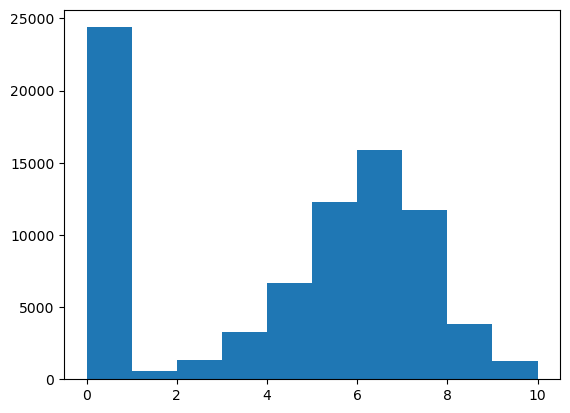

In [28]:
%matplotlib inline
# Make a histogram of all the ratings in the average_rating column
plt.hist(games["average_rating"])
plt.show()

In [30]:
# Print the first row of all the games with zero scores
games[games["average_rating"]==0].iloc[0]

id                             318
type                     boardgame
name                    Looney Leo
yearpublished                  0.0
minplayers                     0.0
maxplayers                     0.0
playingtime                    0.0
minplaytime                    0.0
maxplaytime                    0.0
minage                         0.0
users_rated                      0
average_rating                 0.0
bayes_average_rating           0.0
total_owners                     0
total_traders                    0
total_wanters                    0
total_wishers                    1
total_comments                   0
total_weights                    0
average_weight                 0.0
Name: 13048, dtype: object

In [31]:
#The first row of games with zero scores
games[games["average_rating"]>0].iloc[0]

id                                  12333
type                            boardgame
name                    Twilight Struggle
yearpublished                      2005.0
minplayers                            2.0
maxplayers                            2.0
playingtime                         180.0
minplaytime                         180.0
maxplaytime                         180.0
minage                               13.0
users_rated                         20113
average_rating                    8.33774
bayes_average_rating              8.22186
total_owners                        26647
total_traders                         372
total_wanters                        1219
total_wishers                        5865
total_comments                       5347
total_weights                        2562
average_weight                     3.4785
Name: 0, dtype: object

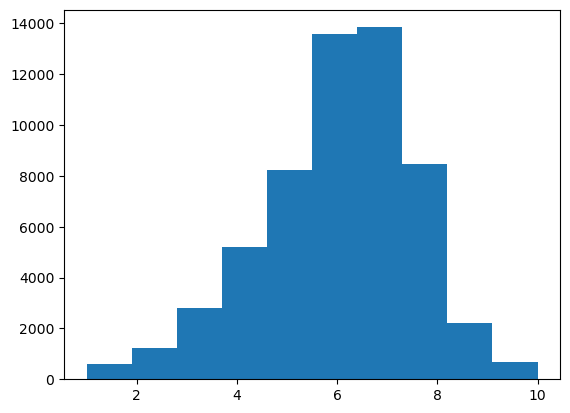

In [33]:
#Remove any rows without user reviews
games  = games[games["users_rated"]>0]

#Remove any Rows with missing values
games = games.dropna(axis = 0)

plt.hist(games["average_rating"])
plt.show()

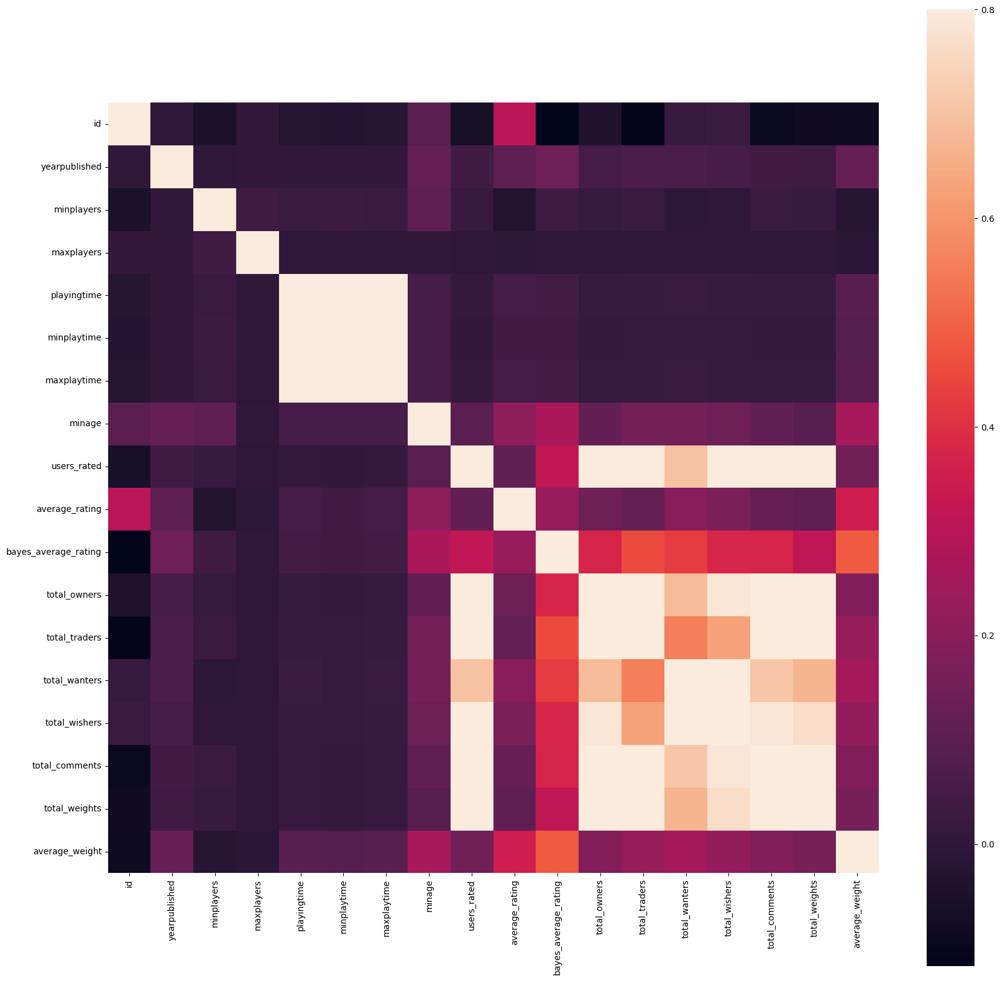

In [34]:
#Correlation matrix
corrmat = games.corr()
fig = plt.figure(figsize = (20,20))

sns.heatmap(corrmat,vmax = .8, square = True)
plt.show()

In [69]:
#Get all the columns from the dataframe
columns = games.columns.tolist()

#Filter the columns to remove data we do not want 
columns = [c for c in columns if c not in ["bayes_average_rating" ,"id","average_rating","name","type"]]

#Store the variable we'll be predicting on 
target = games["average_rating"]
x = games.drop(columns = ["average_rating","type","name","id"])

In [70]:
#Generate training and test dataset
x_train , x_test , y_train, y_test = train_test_split(x,target,test_size = .2,random_state = 1)

In [71]:
# import linear regression model
from sklearn.linear_model import LinearRegression 
from sklearn.metrics import mean_squared_error

#Initialised the model class 
LR =  LinearRegression()

#Fit the model the training data
LR.fit(x_train,y_train)

LinearRegression()

In [72]:
#Generate prediction for the test set 
prediction  = LR.predict(x_test)

In [73]:
prediction

array([7.16716068, 6.60596689, 6.26921629, ..., 5.74943854, 6.42633391,
       5.93559706])

In [74]:
#Compute error between our test prediction and actual 
mean_squared_error(prediction,y_test)

2.087958136994577

In [75]:
LR.score(x_test,y_test)

0.15636014573106372

In [76]:
#Import the random forest model
from sklearn.ensemble import RandomForestRegressor

#Initialized the model 
RFR = RandomForestRegressor(n_estimators = 100,min_samples_leaf= 10, random_state =1)

#Fit to the data 
RFR.fit(x_train,y_train)

RandomForestRegressor(min_samples_leaf=10, random_state=1)

In [77]:
#make prediction 
prediction = RFR.predict(x_test)

In [78]:
#Compute the error  between our test prediction and actual values
mean_squared_error(prediction,y_test)

1.4120288198787412

In [79]:
RFR.score(x_test,y_test)

0.4294695057724074

In [107]:
#Make prediction with  both models
rating_LR = LR.predict(x_test)

rating_LR

array([7.16716068, 6.60596689, 6.26921629, ..., 5.74943854, 6.42633391,
       5.93559706])

In [109]:
rating_RFR = RFR.predict(x_test)
rating_RFR

array([7.13401731, 6.28896009, 6.04263038, ..., 6.47798896, 6.27663428,
       5.9366944 ])

In [112]:
y_test

2602     7.06652
9023     6.40455
13467    5.97500
16387    6.16667
21392    5.75000
          ...   
73459    6.39167
5660     6.18803
57886    5.81250
73263    5.89970
9824     5.84082
Name: average_rating, Length: 11379, dtype: float64